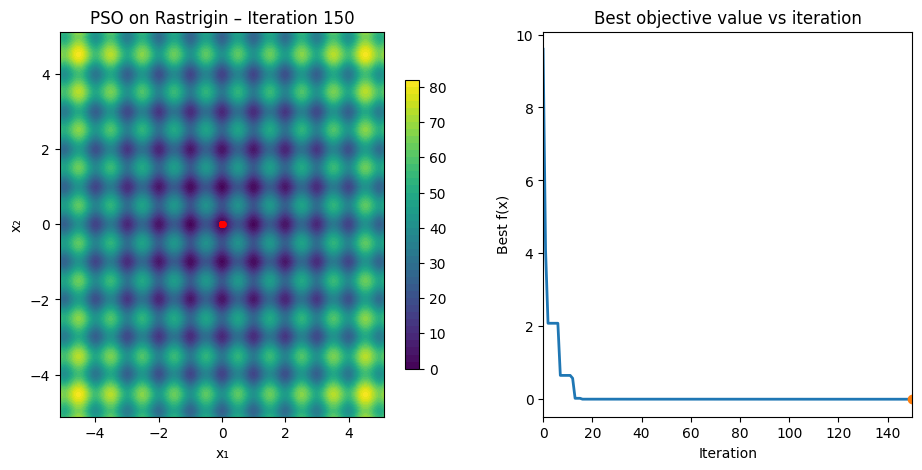

In [1]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from IPython.display import HTML

# ----------------------------
# Rastrigin function (2D test function for optimisation)
# Highly multimodal with many local minima and a global minimum at (0,0).
# Used widely as a benchmark for optimisation algorithms.
# ----------------------------
def rastrigin(X):
    A = 10.0
    return A * X.shape[-1] + np.sum(X**2 - A * np.cos(2 * np.pi * X), axis=-1)

# ----------------------------
# Particle Swarm Optimisation (PSO) in 2D
# - Each particle has a position and velocity
# - Tracks its personal best (pbest) and the global best (gbest)
# - On each iteration, velocity and position are updated
# ----------------------------
class PSO:
    def __init__(self, func, bounds, n_particles=150, w=0.7, c1=1.5, c2=1.5, seed=42):
        self.func = func
        self.bounds = np.array(bounds, dtype=float)
        self.dim = len(bounds)
        self.rng = np.random.default_rng(seed)

        # initialise particle positions (uniform within bounds)
        lo, hi = self.bounds[:, 0], self.bounds[:, 1]
        self.X = self.rng.uniform(lo, hi, size=(n_particles, self.dim))
        # initialise velocities (small random values)
        self.V = self.rng.uniform(-1, 1, size=(n_particles, self.dim))

        # personal bests start at initial positions
        self.pbest = self.X.copy()
        self.pbest_val = self.func(self.X)

        # global best starts from the best personal best
        g_idx = np.argmin(self.pbest_val)
        self.gbest = self.pbest[g_idx].copy()
        self.gbest_val = self.pbest_val[g_idx]

        # PSO hyperparameters
        self.w, self.c1, self.c2 = w, c1, c2

        # For history and visualisation
        self.history = [self.X.copy()]       # positions at each iteration
        self.best_curve = [self.gbest_val]   # global best objective value
        self.gbest_hist = [self.gbest.copy()]# global best position

    def step(self):
        # Random coefficients
        r1 = self.rng.random(self.X.shape)
        r2 = self.rng.random(self.X.shape)

        # Velocity update = inertia + cognitive attraction + social attraction
        self.V = (self.w * self.V +
                  self.c1 * r1 * (self.pbest - self.X) +
                  self.c2 * r2 * (self.gbest - self.X))

        # Update positions
        self.X = self.X + self.V

        # Clamp positions inside search bounds
        lo, hi = self.bounds[:, 0], self.bounds[:, 1]
        self.X = np.clip(self.X, lo, hi)

        # Evaluate objective
        vals = self.func(self.X)

        # Update personal bests
        improved = vals < self.pbest_val
        self.pbest[improved] = self.X[improved]
        self.pbest_val[improved] = vals[improved]

        # Update global best
        g_idx = np.argmin(self.pbest_val)
        if self.pbest_val[g_idx] < self.gbest_val:
            self.gbest = self.pbest[g_idx].copy()
            self.gbest_val = self.pbest_val[g_idx]

        # Record history for animation
        self.history.append(self.X.copy())
        self.best_curve.append(self.gbest_val)
        self.gbest_hist.append(self.gbest.copy())

# ----------------------------
# Run PSO
# ----------------------------
bounds = [(-5.12, 5.12), (-5.12, 5.12)]  # 2D search space
pso = PSO(rastrigin, bounds, n_particles=40)
for _ in range(150):  # iterations
    pso.step()

# ----------------------------
# Background contour of Rastrigin function
# ----------------------------
x = np.linspace(bounds[0][0], bounds[0][1], 300)
y = np.linspace(bounds[1][0], bounds[1][1], 300)
X, Y = np.meshgrid(x, y)
Z = rastrigin(np.stack([X, Y], axis=-1))

# ----------------------------
# Two-panel figure:
#   Left  = particle movement over contour
#   Right = best objective value vs iteration
# ----------------------------
fig, (axL, axR) = plt.subplots(
    1, 2, figsize=(11, 5), gridspec_kw={'width_ratios': [1.1, 1.0]}
)

# Left: contour + red particles
cs = axL.contourf(X, Y, Z, levels=50, cmap="viridis")
fig.colorbar(cs, ax=axL, shrink=0.75)
particles, = axL.plot([], [], 'ro', ms=4)  # swarm particles (red dots)
axL.set_title("Particle Swarm Optimization on Rastrigin")
axL.set_xlabel("x₁"); axL.set_ylabel("x₂")

# Right: convergence curve
iters = np.arange(len(pso.best_curve))
axR.set_title("Best objective value vs iteration")
axR.set_xlabel("Iteration")
axR.set_ylabel("Best f(x)")

# Fix y-limits with margin
y_min = min(pso.best_curve)
y_max = max(pso.best_curve)
pad = 0.05 * (y_max - y_min + 1e-9)
axR.set_xlim(0, len(pso.best_curve) - 1)
axR.set_ylim(y_min - pad, y_max + pad)

# Line for best curve and moving dot for current iteration
line_best, = axR.plot([], [], lw=2)
dot_curr,  = axR.plot([], [], 'o', ms=6)

# ----------------------------
# Animation function
# Updates both left and right subplots per frame
# ----------------------------
def update(frame):
    # Update particle positions on contour
    pos = pso.history[frame]
    particles.set_data(pos[:, 0], pos[:, 1])
    axL.set_title(f"PSO on Rastrigin – Iteration {frame}")

    # Update convergence plot
    xdata = iters[:frame+1]
    ydata = pso.best_curve[:frame+1]
    line_best.set_data(xdata, ydata)
    dot_curr.set_data([xdata[-1]], [ydata[-1]])

    return particles, line_best, dot_curr

# ----------------------------
# Run animation
# ----------------------------
anim = FuncAnimation(fig, update, frames=len(pso.history), interval=120, blit=True)
HTML(anim.to_jshtml())
